In [ ]:
%pip install tensorflow 

In [3]:
import tensorflow as tf # used to train and build the model
import tensorflow.keras as keras
import numpy as np # data manipulation, transformation, and numerical computations
import pandas as pd # data preprocessing, cleaning, and organization
import seaborn as sns # statistical graphics
import matplotlib.pyplot as plt # creating plots
import matplotlib.image as mpimg # reading and displaying images
from tensorflow.keras import layers, models # to define layers such as Dense, Conv2D, MaxPooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator # generate batches of image data
import os # interacting with the OS, used to perform file operations


In [4]:
gpus = tf.config.experimental.list_physical_devices('CPU')

In [6]:
#avoiding out of memory errors
gpus = tf.config.experimental.list_physical_devices('GPU') # setting gpu consumption
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

In [ ]:
import cv2 # image processing
from PIL import Image
import imghdr # determine the image file type

In [8]:
data_dir = 'C:\CS\data' #  the directory path where the data is located
print(os.listdir(data_dir)) # lists all that is present in this directory
print(os.listdir(os.path.join(data_dir, 'clipart'))) # used to navigate through file structures

['clipart', 'infograph', 'painting', 'quickdraw', 'real', 'sketch']
['aircraft_carrier', 'airplane', 'alarm_clock', 'ambulance', 'angel', 'animal_migration', 'ant', 'anvil', 'apple', 'arm', 'asparagus', 'axe', 'backpack', 'banana', 'bandage', 'barn', 'baseball', 'baseball_bat', 'basket', 'basketball', 'bat', 'bathtub', 'beach', 'bear', 'beard', 'bed', 'bee', 'belt', 'bench', 'bicycle', 'binoculars', 'bird', 'birthday_cake', 'blackberry', 'blueberry', 'book', 'boomerang', 'bottlecap', 'bowtie', 'bracelet', 'brain', 'bread', 'bridge', 'broccoli', 'broom', 'bucket', 'bulldozer', 'bus', 'bush', 'butterfly', 'cactus', 'cake', 'calculator', 'calendar', 'camel', 'camera', 'camouflage', 'campfire', 'candle', 'cannon', 'canoe', 'car', 'carrot', 'castle', 'cat', 'ceiling_fan', 'cello', 'cell_phone', 'chair', 'chandelier', 'church', 'circle', 'clarinet', 'clock', 'cloud', 'coffee_cup', 'compass', 'computer', 'cookie', 'cooler', 'couch', 'cow', 'crab', 'crayon', 'crocodile', 'crown', 'cruise_ship'

In [62]:
image_exts = ['jpeg', 'jpg', 'png']  # List of valid image extensions

for image_class in sorted(os.listdir(data_dir)):
    for image in sorted(os.listdir(os.path.join(data_dir, image_class))):
        image_path = os.path.join(data_dir, image_class, image)
        try:
            with Image.open(image_path) as img:
                if img.format.lower() not in image_exts:
                    print('Removing image:', image_path)
                    os.remove(image_path)
        except Exception as e:
            print('Issue with image:', image_path)

Issue with image: C:\CS\data\clipart\The_Eiffel_Tower
Issue with image: C:\CS\data\clipart\The_Great_Wall_of_China
Issue with image: C:\CS\data\clipart\The_Mona_Lisa
Issue with image: C:\CS\data\clipart\aircraft_carrier
Issue with image: C:\CS\data\clipart\airplane
Issue with image: C:\CS\data\clipart\alarm_clock
Issue with image: C:\CS\data\clipart\ambulance
Issue with image: C:\CS\data\clipart\angel
Issue with image: C:\CS\data\clipart\animal_migration
Issue with image: C:\CS\data\clipart\ant
Issue with image: C:\CS\data\clipart\anvil
Issue with image: C:\CS\data\clipart\apple
Issue with image: C:\CS\data\clipart\arm
Issue with image: C:\CS\data\clipart\asparagus
Issue with image: C:\CS\data\clipart\axe
Issue with image: C:\CS\data\clipart\backpack
Issue with image: C:\CS\data\clipart\banana
Issue with image: C:\CS\data\clipart\bandage
Issue with image: C:\CS\data\clipart\barn
Issue with image: C:\CS\data\clipart\baseball
Issue with image: C:\CS\data\clipart\baseball_bat
Issue with i

In [64]:
for root, _, files in os.walk(data_dir):
    
    for file in files:
        if file.lower().endswith(('.png', '.jpg', '.jpeg')):
            image_path = os.path.join(root, file)
            print("Processing:", image_path)
# traversing each directory in the directory tree and joining root and filename

            


Processing: C:\CS\data\clipart\aircraft_carrier\clipart_001_000001.jpg
Processing: C:\CS\data\clipart\aircraft_carrier\clipart_001_000002.jpg
Processing: C:\CS\data\clipart\aircraft_carrier\clipart_001_000003.jpg
Processing: C:\CS\data\clipart\aircraft_carrier\clipart_001_000004.jpg
Processing: C:\CS\data\clipart\aircraft_carrier\clipart_001_000005.jpg
Processing: C:\CS\data\clipart\aircraft_carrier\clipart_001_000006.jpg
Processing: C:\CS\data\clipart\aircraft_carrier\clipart_001_000007.jpg
Processing: C:\CS\data\clipart\aircraft_carrier\clipart_001_000008.jpg
Processing: C:\CS\data\clipart\aircraft_carrier\clipart_001_000009.jpg
Processing: C:\CS\data\clipart\aircraft_carrier\clipart_001_000010.jpg
Processing: C:\CS\data\clipart\aircraft_carrier\clipart_001_000011.jpg
Processing: C:\CS\data\clipart\aircraft_carrier\clipart_001_000012.jpg
Processing: C:\CS\data\clipart\aircraft_carrier\clipart_001_000013.jpg
Processing: C:\CS\data\clipart\aircraft_carrier\clipart_001_000014.jpg
Proces

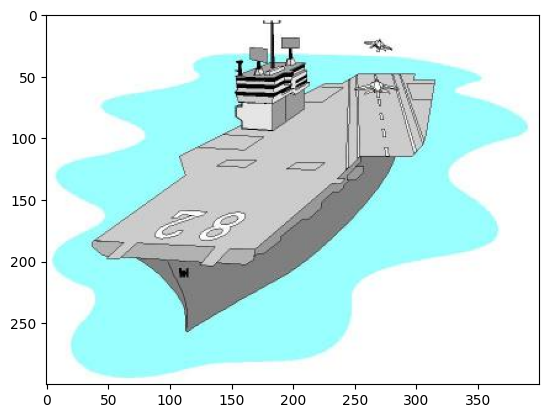

Found 596006 files belonging to 6 classes.


2

In [90]:
img = mpimg.imread('C:\CS\data\clipart\\aircraft_carrier\clipart_001_000010.jpg') # read an image from a file, recc to use PIL
imgplot = plt.imshow(img)
plt.show()
img.shape # rows, cols, channels
type(img)

data = tf.keras.utils.image_dataset_from_directory('C:\CS\data') # loads image data, labels it and creates a dataset
#tf.keras.utils.image_dataset_from_directory('C:\CS\data')??
data_iterator = data.as_numpy_iterator() # iterator to access the bathes as Numpy arrays
batch = data_iterator.next() # the next batch of images and labels in the dataset
len(batch) # batch of data, shape of 2 -> images and labels

In [91]:
scaled = batch[0] / 255 # because the max is 255 -> we need values from 0 to 1
scaled.min()
batch[1] # extracts the array of labels corresponding to each image
# 0 = clipart, 1 = info, 2 = painting, 3 = quickdraw, 4 = real, 5 = sketch

array([3, 3, 3, 4, 4, 3, 0, 3, 1, 3, 3, 3, 5, 5, 0, 4, 3, 2, 3, 4, 3, 2,
       1, 3, 1, 4, 3, 0, 0, 4, 3, 1])

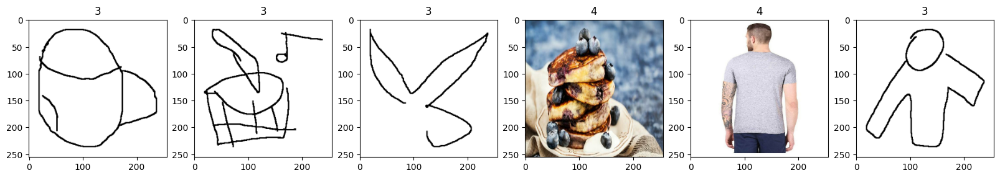

In [92]:
# checking which class is assigned to which image
fig, ax = plt.subplots(ncols=6, figsize=(20,20))
for idx, img in enumerate(batch[0][:6]):
    ax[idx].imshow(img.astype(int))
    ax[idx].title.set_text(batch[1][idx])

In [ ]:
data = data.map(lambda x,y: (x/255, y))# applying a lambda function that takes 2 inputs -> image and label
data.as_numpy_iterator().next()# retrieved as Numpy arrays, returns a tuple with values [0,1]

In [94]:
# splitting the data into training, validation and test
train_size = int(len(data)*.7) #train size needs to be bigger to improve accuracy
val_size = int(len(data)*.2)
test_size = int(len(data)*.1)

train_size

13038

In [95]:
train = data.take(train_size)
val = data.skip(train_size).take(val_size)
test = data.skip(train_size+val_size).take(test_size)

In [53]:
from tensorflow.keras.models import Sequential # class that allows to build layer by layer
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense, Flatten, Dropout
# Conv2D -> preprocess images/2d data , MaxPooling2D to reduce the dimensions and keep the most important features
# Dense -> to connect  each neuron with the prev and next
# Flatten -> to flatten the input data to a 1-dimensional tensor
# Dropout to prevent overfitting 
from tensorflow.keras import layers


In [100]:
model = Sequential() # create a model, layer by layer

In [101]:
model.add(Conv2D(16, (3, 3), 1, activation='relu', input_shape=(256, 256, 3)))
model.add(layers.BatchNormalization())
model.add(MaxPooling2D())

model.add(Conv2D(32, (3, 3), 1, activation='relu'))
model.add(layers.BatchNormalization())
model.add(MaxPooling2D())

model.add(Conv2D(64, (3, 3), 1, activation='relu'))
model.add(layers.BatchNormalization())
model.add(MaxPooling2D())

model.add(Flatten())

model.add(Dense(64, activation='relu'))
model.add(Dropout(0.5))

model.add(Dense(1, activation='softmax'))

In [102]:
model.compile('adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_20 (Conv2D)          (None, 254, 254, 16)      448       
                                                                 
 batch_normalization_12 (Ba  (None, 254, 254, 16)      64        
 tchNormalization)                                               
                                                                 
 max_pooling2d_12 (MaxPooli  (None, 127, 127, 16)      0         
 ng2D)                                                           
                                                                 
 conv2d_21 (Conv2D)          (None, 125, 125, 32)      4640      
                                                                 
 batch_normalization_13 (Ba  (None, 125, 125, 32)      128       
 tchNormalization)                                               
                                                      

In [ ]:
logdir='logs' # where TensorBoard logs are saved
# below is used to visualize and monitor the training process
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logdir) 
#below is used to train the model, taking the input data and iterating it 6 times
hist = model.fit(train, epochs=6, validation_data=val, callbacks=[tensorboard_callback])

In [ ]:
fig = plt.figure()
plt.plot(hist.history['loss'], color='teal', label='loss')
plt.plot(hist.history['val_loss'], color='orange', label='val_loss')
fig.suptitle('Loss', fontsize=20)
plt.legend(loc="upper left")
plt.show()

In [ ]:
fig = plt.figure()
plt.plot(hist.history['accuracy'], color='teal', label='accuracy')
plt.plot(hist.history['val_accuracy'], color='orange', label='val_accuracy')
fig.suptitle('Accuracy', fontsize=20)
plt.legend(loc="upper left")
plt.show()